In [3]:
# import stuff
import os,sys
import glob
import pandas
from osgeo import gdal
import datetime 
from datetime import datetime
from datetime import timedelta
from dateutil import parser
import numpy as np
from scipy.ndimage import uniform_filter, gaussian_filter
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib import cm
from extract_transect import extract_transect
from filter_1D_profile_and_unwrap import unwrap_1D
%matplotlib  widget

Set up working directory, locations of pixels for comparison, and dates of SLCs

In [4]:
# how many dates do we have? 
workdir = '/data/ocp4/LagunaSalada/'
alooks=4
rlooks=20
#cropdir='cropped_9000_20_10000_1780/'
cropdir='cropped_9000_1800_18000_3600/'

# this is a shorter one 
x1=9234   
y1=1345   
x2=10000 
y2=1500 
# this is a longer one, doesn't really work because agriculture messes it all up 
#x1=8000
#y1=1100  
#x2=10500 
#y2=1600

dates = [os.path.basename(x) for x in glob.glob(workdir+cropdir+"SLC_vv/2*")]
dates=sorted(dates)
print(str(len(dates))+' dates so far!')
nd=len(dates)
#print(type(dates[0])) # these are strings 
print(dates)

# put these into datetime objects 
str_dates = [datetime.strptime(date,'%Y%m%d') for date in dates]

211 dates so far!
['20170510', '20170522', '20170603', '20170615', '20170627', '20170709', '20170721', '20170802', '20170814', '20170826', '20170907', '20170919', '20171013', '20171025', '20171106', '20171118', '20171130', '20171212', '20171224', '20180105', '20180117', '20180129', '20180210', '20180222', '20180306', '20180318', '20180330', '20180411', '20180423', '20180505', '20180517', '20180529', '20180610', '20180622', '20180704', '20180716', '20180728', '20180809', '20180821', '20180902', '20180914', '20180926', '20181008', '20181020', '20181101', '20181113', '20181125', '20181207', '20181219', '20181231', '20190112', '20190124', '20190205', '20190217', '20190301', '20190313', '20190325', '20190406', '20190430', '20190512', '20190524', '20190605', '20190617', '20190629', '20190711', '20190723', '20190804', '20190816', '20190822', '20190828', '20190903', '20190909', '20190915', '20190921', '20190927', '20191003', '20191009', '20191015', '20191021', '20191027', '20191102', '20191108

<br> Plot a map of triplet phase closure to show points spatially and why I chose those locations

In [5]:
# plot a map of triplet phase closure to show where the points are that I chose to compare
# x1,y1 shows weird tpc signal
# x2,y2 is used as reference point

date1='20190112'
date2='20190124'
date3='20190205'

x0=0; dx=18000; y0=0; dy=3600 # changes with different subregion
alooks=4; rlooks=20

ds = gdal.Open(workdir+"/"+cropdir+"/SLC_vv/"+date1+"/"+date1+".slc.full", \
               gdal.GA_ReadOnly)
slc1 = ds.GetRasterBand(1).ReadAsArray(x0,y0,dx,dy)
ds = gdal.Open(workdir+"/"+cropdir+"/SLC_vv/"+date2+"/"+date2+".slc.full", \
               gdal.GA_ReadOnly)
slc2 = ds.GetRasterBand(1).ReadAsArray(x0,y0,dx,dy)
ds = gdal.Open(workdir+"/"+cropdir+"/SLC_vv/"+date3+"/"+date3+".slc.full", \
               gdal.GA_ReadOnly)
slc3 = ds.GetRasterBand(1).ReadAsArray(x0,y0,dx,dy)

# 4 SLCs, can make 3 sequential igrams
int12 = slc1 * np.conj(slc2)
int23 = slc2 * np.conj(slc3)
# and 2 nonsequential (skip a date)
int31 = slc3 * np.conj(slc1)

# now filter them by alooks/rlooks 
int12filt = uniform_filter((int12), size=[alooks,rlooks])
int23filt = uniform_filter((int23), size=[alooks,rlooks])
int31filt = uniform_filter((int31), size=[alooks,rlooks])

# normalizing, didn't change anything 
#int12filt = np.exp(1j*np.angle(int12filt))
#int23filt = np.exp(1j*np.angle(int23filt))
#int31filt = np.exp(1j*np.angle(int31filt))

tpc123 = np.angle(int12filt*int23filt*int31filt)

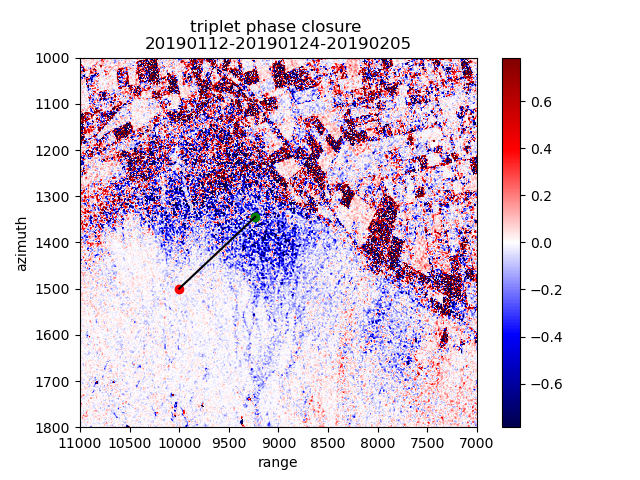

In [6]:
# now plot it spatially 
#plt.figure(figsize=(5, 5))
plt.figure()
plt.imshow(tpc123,vmin=-np.pi/4, vmax=np.pi/4, cmap='seismic', aspect='auto', \
           interpolation='nearest') # previously had cmap='jet'
plt.ylabel('azimuth')
plt.xlabel('range')
plt.title("triplet phase closure \n"+str(date1)+"-"+str(date2)+"-"+str(date3))
plt.colorbar()
plt.xlim(dx, 0)
plt.plot(x1,y1,'go')
plt.plot(x2,y2,'ro')

line1=([x1,x2],[y1,y2])
plt.plot(line1[0],line1[1],'k-')

# Zoomed in 
plt.xlim([11000,7000])
plt.ylim([1800,1000])


plt.show()

In [5]:
# plot a transect of TPC, make sure it works 
tpcTsct = extract_transect(tpc123, [x1,y1], [x2,y2], 25, 5)
tpcTsct = np.real(tpcTsct)
#print(tpcTsct)

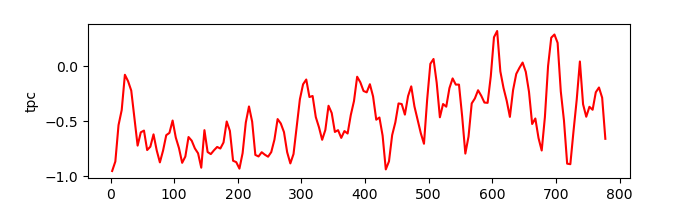

In [6]:
plt.figure(figsize=(7,2))
plt.plot(tpcTsct[0],tpcTsct[1],'r-',markersize=5)
# this should be coherence measure as color 
plt.ylabel('tpc'); plt.xlabel('profile dist')
plt.show()

Initialize arrays and put (alooks x rlooks) extracted portion of SLC around each pixel in the arrays. <br> Indexing: [slc][azimuth][range]

In [7]:
# initializing empty arrays, they are 3 dimensional 
# will contain a layer for each date with layer containing alooks x rlooks pixels from each SLC
slcx1=np.ndarray([len(dates),alooks,rlooks],'complex')
slcx2=np.ndarray([len(dates),alooks,rlooks],'complex')

# pull out the alooks x rlooks box of pixels from pixel in Cerro Prieto geothermal field  
for i in np.arange(nd):
    ds = gdal.Open(workdir+cropdir+"SLC_vv/"+dates[i]+"/"+dates[i]+".slc.full", \
                   gdal.GA_ReadOnly)
    slcx1[i,:,:] = ds.GetRasterBand(1).ReadAsArray(x1-rlooks/2,y1-alooks/2,rlooks,alooks)

# do the same for the pixel just outside of CP geotherm field 
for i in np.arange(nd):
    ds = gdal.Open(workdir+cropdir+"SLC_vv/"+dates[i]+"/"+dates[i]+".slc.full", \
                   gdal.GA_ReadOnly)
    slcx2[i,:,:] = ds.GetRasterBand(1).ReadAsArray(x2-rlooks/2,y2-alooks/2,rlooks,alooks)

Make SLC dates into time objects (better for plotting). Also calculate differences between dates for later calculating displacement/time (12-day and 6-day pairs)

In [8]:
# calculate phase change over each igram interval 
# dates is a list of strings, from cell above.
# convert strings to datetime objects 
slc_dates=[]
for i in range(0,len(dates)):
    slc_dates.append(datetime.strptime(str(dates[i]).replace('\n',''), '%Y%m%d'))
# calculate dt between slcs 
dt = np.diff(slc_dates)
# these are now timedelta objects
# convert to floats 
dt2 = np.zeros([len(dt),1])
for i in range(0,len(dt)):
    dt2[i] = dt[i].days

Calculate displacement between 2 pixels in each igram, and the coherence for each igram (average coherence from 2 coherence values, one from each pixel)

In [9]:
# initialize empty nd x nd array for storing coherence values for each SLC pair/igram
# phase is difference (conjugate) between  at pt 1 and pt 2
allphase=np.zeros([nd-1,1])
coh=np.zeros([nd-1,1])

# assigning integer values to SLC pairs 
numints = np.cumsum(np.arange(nd))
numints=np.max(numints)
# what does this do?
ids=np.ndarray([numints,2])

# making interferograms, looping thru i, j dates 
for i in np.arange(nd-1):
    j = i+1
    # is is first date, j is comparison date

    # Using this method: <a b*> / <abs(a b*)>

    # a b*
    ints=slcx1[i,:,:] * np.conj(slcx1[j,:,:])
    ints2=slcx2[i,:,:] * np.conj(slcx2[j,:,:])
    # take the mean over all the pixels in this area (complex space) complex coherence
    # <a b*>
    cov=np.mean(ints,axis=(0,1)) # complex number, of which phase is angle 
    # mag of this is the coherence at that point 
    cov2=np.mean(ints2,axis=(0,1))
    # <abs (a b*)>
    intmag=np.mean(np.abs(ints),axis=(0,1))
    intmag2=np.mean(np.abs(ints2),axis=(0,1))
    # coherence magnitude, simplest way of doing it 
    # <a b*> / <abs(a b*)>
    covw = cov/intmag
    covw2 = cov2/intmag2
    # put these into a 2-element array
    toAvg = [covw, covw2]
    # average the two coherence magnitudes from the two points
    coh[i] = np.mean(np.abs(toAvg))

    # now we have covs at pt 1 and 2 
    allphase[i]=np.angle(cov*np.conj(cov2))

    # angle instead of mag
    #allphase[i,j]=np.angle(covw)  

cumulative = np.cumsum(allphase)

In [10]:
#CONVERTING RADIANS TO CM 
# element by element multiplication, just in case
#allphase2 = np.multiply(allphase,dt2) # so this is radians/year now
dispcm = allphase*5.6/(4*np.pi) # disp/igram
ratecm = dispcm*365.25/dt2
cumulative2 = np.cumsum(dispcm,0)
# try a cumulative sum? See them go up? 
#print(np.shape(cumulative2))
#print(np.shape(disp))
avgrate = np.mean(ratecm)
print('Average rate = '+str(avgrate))

Average rate = 0.12029595986532675


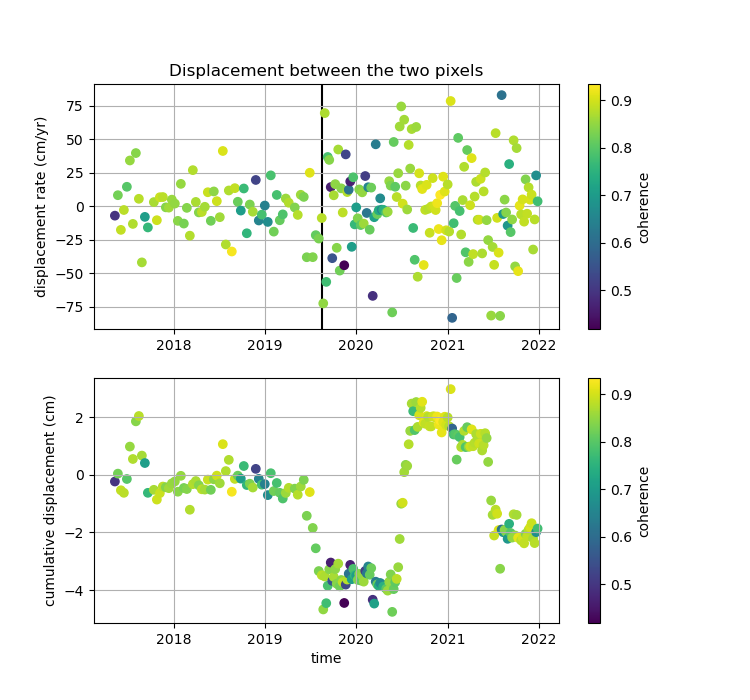

In [11]:
#plot disp+cumulative disp between the 2 pixels in cm/yr
plt.figure(figsize=(7.5, 7))
ax = plt.subplot(2, 1, 1)
# 20190816 is when the 6-day pairs started 
plt.axvline(x = datetime(2019, 8, 16, 0, 0), color='k', zorder=1)
plt.scatter(slc_dates[0:-1], ratecm, c=coh, zorder=2)
plt.grid('on')
cbar = plt.colorbar()
cbar.set_label('coherence')
#plt.xlim([np.min(slc_dates), np.max(slc_dates)])
plt.ylabel('displacement rate (cm/yr)')
plt.title('Displacement between the two pixels')

ax = plt.subplot(2, 1, 2)
plt.scatter(slc_dates[0:-1], cumulative2, c=coh)
plt.grid('on')
cbar = plt.colorbar()
cbar.set_label('coherence')
plt.xlabel('time')
plt.ylabel('cumulative displacement (cm)')

plt.show()


# 12-day pairs are less noisy 
# put a line where switches over from 12-day to 6-day pairs 

Calculate and plot triplet phase closure at a pixel and plot disp/cumulative disp btw the points, now colored by TPC

In [12]:
# calculate triplet phase closure
# initialize arrays
x1tpc=np.ndarray([len(dates)-2],'complex')
x2tpc=np.ndarray([len(dates)-2],'complex')

skip1 = slcx1[0:-1,:,:]*np.conj(slcx1[1:,:,:]) # makes igrams first
skip2 = slcx1[2:,:,:]*np.conj(slcx1[0:-2,:,:])
#####Could normalize all of these by amplitude before taking the mean, tooo!!!
#skip1 = skip1/abs(skip1)
#skip2 = skip2/abs(skip2)
skip1 = np.mean(skip1,axis=(1,2)) # now average them (same as downlooking)
skip2 = np.mean(skip2,axis=(1,2))

# exclude the 0th term and the last term 
for i in np.arange(0,nd-2,1):
    ab = skip1[i]
    bc = skip1[i+1]
    ca = skip2[i]
    ab = np.exp(1j*np.angle(ab)) # normalizing to length 1
    bc = np.exp(1j*np.angle(bc)) # same as bc/abs(bc)
    ca = np.exp(1j*np.angle(ca))
    x1tpc[i] = ab*bc*ca

skip1 = slcx2[0:-1,:,:]*np.conj(slcx2[1:,:,:]) # makes igrams first
skip2 = slcx2[2:,:,:]*np.conj(slcx2[0:-2,:,:])
#####Could normalize all of these by amplitude before taking the mean, tooo!!!
#skip1 = skip1/abs(skip1)
#skip2 = skip2/abs(skip2)
skip1 = np.mean(skip1,axis=(1,2)) # now average them (same as downlooking)
skip2 = np.mean(skip2,axis=(1,2))   
    
for i in np.arange(0,nd-2,1):
    ab = skip1[i]
    bc = skip1[i+1]
    ca = skip2[i]
    ab = np.exp(1j*np.angle(ab)) # normalizing to length 1
    bc = np.exp(1j*np.angle(bc)) # same as bc/abs(bc)
    ca = np.exp(1j*np.angle(ca))
    x2tpc[i] = ab*bc*ca

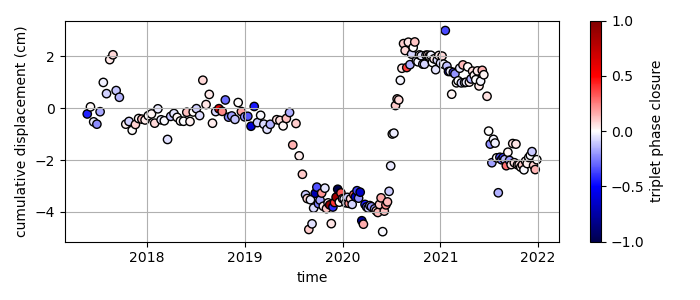

In [13]:
# plot cumulative displacement but colored by triplet phase closure (on center date I believe)

plt.figure(figsize=(7, 3), tight_layout=True)
ax = plt.subplot(1, 1, 1)
plt.grid('on')
# can do one or the other, similar though 
plt.scatter(slc_dates[1:-1], cumulative2[0:-1], c=np.angle(x1tpc), cmap='seismic', \
            edgecolors='k')
plt.clim(-1,1)
#plt.scatter(slc_dates[1:-1], cumulative2[0:-1], c=np.angle(x2tpc))
cbar = plt.colorbar()
cbar.set_label('triplet phase closure')
plt.xlabel('time')
plt.ylabel('cumulative displacement (cm)')
plt.show()

<br> <br> Plot cross-sections of phase vs. distance across the TPC anomaly <br>

In [14]:
# Remind what transect I'm trying to extract
print('x1 = '+str(x1))
print('x2 = '+str(x2))
print('y1 = '+str(y1))
print('y2 = '+str(y2))
Dx = x2-x1
Dy = y2-y1
print('Dx = '+str(Dx))
print('Dy = '+str(Dy))

x1 = 9234
x2 = 10000
y1 = 1345
y2 = 1500
Dx = 766
Dy = 155


In [15]:
# what slc date do I want to start at? then convert to datetime object.
# try '20200711' next
#startDate = '20190711'
#startDate = '20181020'
startDate = '20170510' # beginning of data
date1 = datetime.strptime(str(startDate).replace('\n',''), '%Y%m%d')
# find which index corresponds to this date: 
indexDate1 = slc_dates.index(date1)
print(indexDate1)
print(slc_dates[indexDate1])
# how many slcs do I need to load? 
numigrams = 210
numSLCs = numigrams+1
#for i in np.arange(indexDate1, indexDate1+numSLCs):
    #print(dates[i]) # these are strings
    
# put the dates into an array for plotting 
# str_dates are already in datetiime objects, just extract the right dates 
plotDates = str_dates[indexDate1:indexDate1+numigrams]

for i in np.arange(len(plotDates)):
    plotDates[i] = datetime.strftime(plotDates[i],'%m-%d-%Y')
    
print(plotDates)

0
2017-05-10 00:00:00
['05-10-2017', '05-22-2017', '06-03-2017', '06-15-2017', '06-27-2017', '07-09-2017', '07-21-2017', '08-02-2017', '08-14-2017', '08-26-2017', '09-07-2017', '09-19-2017', '10-13-2017', '10-25-2017', '11-06-2017', '11-18-2017', '11-30-2017', '12-12-2017', '12-24-2017', '01-05-2018', '01-17-2018', '01-29-2018', '02-10-2018', '02-22-2018', '03-06-2018', '03-18-2018', '03-30-2018', '04-11-2018', '04-23-2018', '05-05-2018', '05-17-2018', '05-29-2018', '06-10-2018', '06-22-2018', '07-04-2018', '07-16-2018', '07-28-2018', '08-09-2018', '08-21-2018', '09-02-2018', '09-14-2018', '09-26-2018', '10-08-2018', '10-20-2018', '11-01-2018', '11-13-2018', '11-25-2018', '12-07-2018', '12-19-2018', '12-31-2018', '01-12-2019', '01-24-2019', '02-05-2019', '02-17-2019', '03-01-2019', '03-13-2019', '03-25-2019', '04-06-2019', '04-30-2019', '05-12-2019', '05-24-2019', '06-05-2019', '06-17-2019', '06-29-2019', '07-11-2019', '07-23-2019', '08-04-2019', '08-16-2019', '08-22-2019', '08-28-2019

In [16]:
# loop through and load in the slcs, extract the data
SLCs=np.ndarray([numSLCs,Dy,Dx],'complex')
# defined above: 
print('shape of SLCs array: '+str(np.shape(SLCs)))
# starts at the first date, goes through the number of igrams defined above
for i in np.arange(indexDate1, indexDate1+numSLCs):    
    ds = gdal.Open(workdir+cropdir+"SLC_vv/"+dates[i]+"/"+dates[i]+".slc.full", \
                    gdal.GA_ReadOnly)
    SLCs[i-indexDate1,:,:] = ds.GetRasterBand(1).ReadAsArray(x1,y1,Dx,Dy)
    #print('slc '+str(i))  
# now we have all the SLCs extracted, make igrams 
igrams = SLCs[0:-1,:,:]*np.conj(SLCs[1:,:,:])
print('igrams made for small area')
print('shape of igrams array: '+str(np.shape(igrams)))
print(type(igrams[0,0,0]))

shape of SLCs array: (211, 155, 766)
igrams made for small area
shape of igrams array: (210, 155, 766)
<class 'numpy.complex128'>


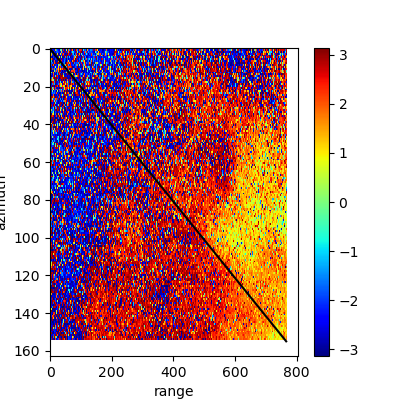

In [17]:
# now single igram to make sure it worked 
plt.figure(figsize=(4, 4))
plt.imshow(np.angle(igrams[118]),vmin=-np.pi, vmax=np.pi, cmap='jet', aspect='auto', \
           interpolation='nearest')
plt.plot([0,x2-x1],[0,y2-y1],'k-')
plt.ylabel('azimuth')
plt.xlabel('range')
plt.colorbar()
plt.show()
# great, it worked!

In [18]:
# start by just doing one to test it 
start1 = [0,0]
end1 = [x2-x1,y2-y1]
transectTest = extract_transect(igrams[153], start1, end1, 10, 10)

# 39 problem at std=4
# 73 problem at std=10

print(np.shape(transectTest))
#print(transectTest[1,0:-1])
#now unwrap it
unwrappedTest = unwrap_1D(transectTest,5,np.pi)
# can play around with std above for specific transects to see what works best 

print(np.shape(np.abs(transectTest[1])))
print(np.shape(unwrappedTest[0]))
#print(np.abs(transectTest[1,0:20]))
#print(unwrappedTest[1])

(2, 78)
(78,)
(77,)


In [20]:
# for igram 153, need to do one edit manually 
start1 = [0,0]
end1 = [x2-x1,y2-y1]


transectTest153 = extract_transect(igrams[153], start1, end1, 10, 10)
unwrappedTest153 = unwrap_1D(transectTest153,10,np.pi/4)

# duplicate the transect to edit 
unwrap153 = unwrappedTest153
print(unwrap153[1,0])
unwrap153[1,0] = unwrap153[1,0] - np.pi 
print(unwrap153[1,0])

3.872021057816842
0.730428404227049


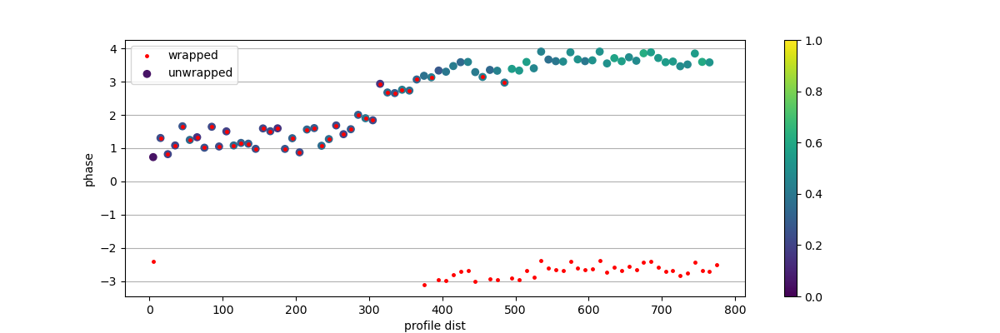

In [21]:
# just plotting one transect at a time, calculated in cell above 

fig = plt.figure(figsize=(12,4))
ax = plt.axes()
#plt.plot(np.real(transectTest[0]),np.angle(transectTest[1]),'r.-',markersize=7,label='wrapped')
plt.plot(np.real(transectTest[0]),np.angle(transectTest[1]),'r.',markersize=5,label='wrapped',zorder=10)
# this should be coherence measure as color 
#plt.scatter(unwrappedTest[0],unwrappedTest[1],c=np.abs(transectTest[1])[0:-1],vmin=0,vmax=1,label='unwrapped',zorder=5)

# see what manually changed transect 173 looks like now
#plt.scatter(unwrap73[0],unwrap73[1],c=np.abs(transectTest[1])[0:-1],vmin=0,vmax=1,label='unwrapped',zorder=5)
plt.scatter(unwrap153[0],unwrap153[1],c=np.abs(transectTest[1])[0:-1],vmin=0,vmax=1,label='unwrapped',zorder=5)


plt.colorbar()
ax.set_ylabel('phase'); plt.xlabel('profile dist')
plt.legend()
ax.grid(which='both',axis='y')
# trying to put gridlines every 2pi intervals 
#ax.yaxis.set_major_locator(MultipleLocator(2*np.pi)
#ax.yaxis.set_minor_locator(AutoMinorLocator(4))
plt.show()

# plot unwrapped+wrapped w/ coherence across transect  
# loop through them all, is the unwrapper working? 
# coherence shows that if ambiguous ~2pi jump, might not be believable 
# add the title = number of pair 
# can go back and see which spatial tuning gives a good result 
# if I have really problematic pair, think about other ways to deal with it, send Rowena a picture of it 

Now loop through the igrams and use the transect tool to extract a transect across each one 

In [22]:
# set inputs to unwrapping function so it stays consistent 
std = 5
cutoff = np.pi # can't go any lower than np.pi/4

# process all the transects and put them into an array 
transect1 = extract_transect(igrams[0], start1, end1, 10, 10)
#print(np.shape(transect1))
transectLength = np.shape(transect1)[1]
# initialize empty array 
transects = np.ndarray([numigrams,2,transectLength],'complex')
#print(np.shape(transects))
transects[0] = transect1
print(np.shape(transects[0]))
# another one for unwrapped versions
UnwrTscts = np.ndarray([numigrams,2,transectLength-1],'complex')
UnwrTscts[0] = unwrap_1D(transects[0],std,cutoff)
#print(np.shape(UnwrTscts))

# cumulative phase transects
UnwrTsctsCum = np.ndarray([numigrams,2,transectLength-1],'complex')
print(np.shape(UnwrTsctsCum))
UnwrTsctsCum[0] = UnwrTscts[0]
#print(UnwrTsctsCum[0,1])

for i in np.arange(1,numigrams):
    transects[i] = extract_transect(igrams[i], start1, end1, 10, 10)
    # started with std=4, cutoff=np.pi/4 but didn't work well for igram #39, starting on 09-02-2018
    # ok now trying larger std, std=6
    UnwrTscts[i] = unwrap_1D(transects[i],std,cutoff)
    #print(UnwrTscts[i,0,0:12])
    #UnwrTsctsCum[i,1] = np.real(UnwrTsctsCum[i-1,1])+np.real(UnwrTscts[i,1])
    UnwrTsctsCum[i] = UnwrTscts[i]
    UnwrTsctsCum[i,1] = UnwrTscts[i-1,1]+UnwrTscts[i,1]

(2, 78)
(210, 2, 77)


In [23]:
#print(transect1)
print(np.shape(transects))
print(np.shape(UnwrTscts))
#print(UnwrTscts[0])
#print(transects[:,1])

(210, 2, 78)
(210, 2, 77)


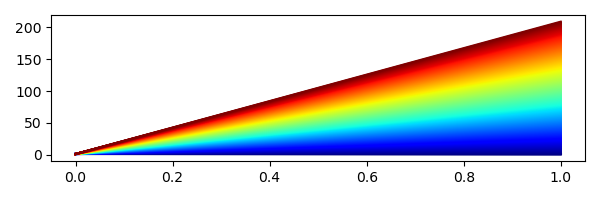

In [24]:
# make a colormap for my plots 
# helpful: https://matplotlib.org/3.1.0/tutorials/colors/colormap-manipulation.html
cmap1 = cm.get_cmap('jet', numigrams)
print(cmap1)
plt.figure(figsize=(6, 2), tight_layout=True)
for i in np.arange(numigrams):
    #print(cmap1(i))
    pt = [1,i]
    plt.plot(pt,markersize=10,c=cmap1(i))

(0.0, 0.6428571428571429, 1.0, 1.0)


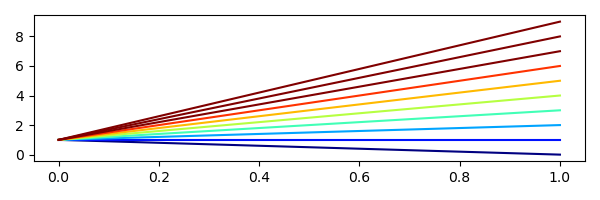

In [25]:
# make a second colormap for my plots 
# helpful: https://matplotlib.org/3.1.0/tutorials/colors/colormap-manipulation.html
cmap2 = cm.get_cmap('jet', 8)
print(cmap2(2))
plt.figure(figsize=(6, 2), tight_layout=True)
for i in np.arange(10):
    pt = [1,i]
    plt.plot(pt,markersize=10,c=cmap2(i))
plt.show()

In [26]:
# import something specific so that I can set gridlines to 2pi intervals 
#    without having to specifcy ylim each time I plot a different transect 
from matplotlib.ticker import MultipleLocator, FormatStrFormatter, AutoMinorLocator
import time

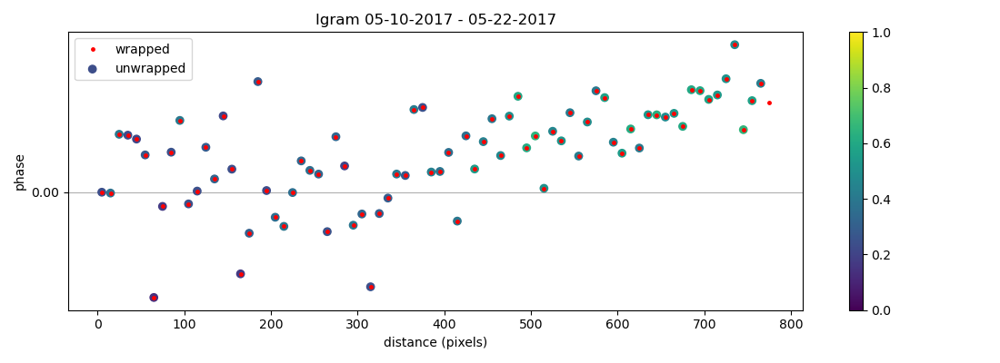

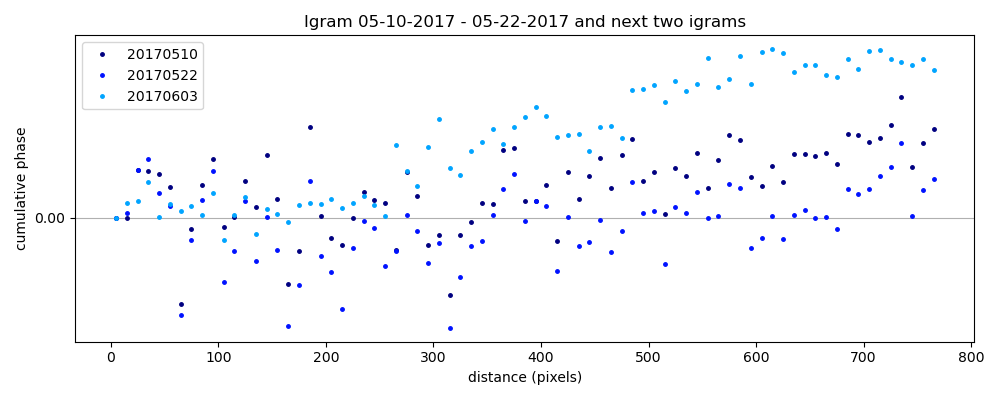

In [27]:
# QUALITY CONTROL: SEEING IF THERE ARE LEFTOVER UNWRAPPING ERRORS
# plot the igram transect, the cumulative transect (with the following two), and the coherence along that transect 

# this is a variable for telling it which igram to plot the transect for 
k = 0;

# plot the transect of igram k with corresponding coherence values 
fig = plt.figure(figsize=(11, 4), tight_layout=True)
ax = plt.axes()
ax.set_ylabel('phase')
ax.set_xlabel('distance (pixels)')
plt.plot(np.real(transects[k,0,:]),np.angle(transects[k,1,:])-np.angle(transects[k,1,0]),'r.',markersize=5,zorder=10,label='wrapped')
plt.scatter(np.real(UnwrTscts[k,0,:]),np.real(UnwrTscts[k,1,:])-np.real(UnwrTscts[k,1,0]),c=np.abs(transects[k,1])[0:-1],vmin=0,vmax=1,zorder=5,label='unwrapped')
plt.title('Igram '+str(plotDates[k])+' - '+str(plotDates[k+1]))
plt.colorbar()
plt.legend()
# trying to put gridlines every 2pi intervals 
ax.yaxis.set_major_locator(MultipleLocator(2*np.pi))
ax.yaxis.set_minor_locator(AutoMinorLocator(4))
ax.grid(which='both',axis='y')
plt.show()

# plot all the cumulative sequential igrams in the specific period of time 
fig = plt.figure(figsize=(10, 4), tight_layout=True)
ax = plt.axes()
plt.ylabel('cumulative phase')
plt.xlabel('distance (pixels)')
for i in np.arange(k,k+3,1):
    #plt.plot(np.real(transects[i,0,:]),np.angle(transects[i,1,:]),'.-',markersize=5,label=dates[i+indexDate1])
    plt.plot(np.real(UnwrTsctsCum[i,0,:]),np.real(UnwrTsctsCum[i,1,:])-np.real(UnwrTsctsCum[i,1,0]),'.',c=cmap2(i-k),markersize=5,label=dates[i+indexDate1])
plt.title('Igram '+str(plotDates[k])+' - '+str(plotDates[k+1])+' and next two igrams')
plt.legend()
ax.grid(which='both',axis='y')
# trying to put gridlines every 2pi intervals 
ax.yaxis.set_major_locator(MultipleLocator(2*np.pi))
ax.yaxis.set_minor_locator(AutoMinorLocator(4))
plt.show()

# added 2pi lines so eye can tell which jumps are unwrapping errors 
# cumulative means nothing if pairs are bad 

In [28]:
# CORRECTING THE Transect that I fixed manually 
UnwrTscts[153,1,:] = unwrap153[1]

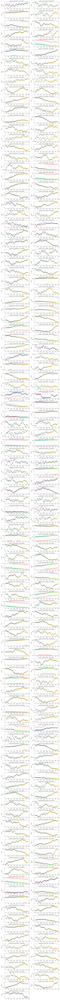

In [29]:
# Plot all transects at once to peruse through for unwrapping errors/messy data 
numRows = int(np.ceil(len(plotDates)/2))
numTscts = len(plotDates)


figAll = plt.figure(figsize=(12,200),tight_layout=True) 

for k in np.arange(numTscts-1):
    axa = plt.subplot(numRows,2,k+1)
    axa.set_ylabel('phase')
    axa.plot(np.real(transects[k,0,:]),np.angle(transects[k,1,:])-np.angle(transects[k,1,0]),'r.',markersize=5,zorder=10,label='wrapped')
    axa.scatter(np.real(UnwrTscts[k,0,:]),np.real(UnwrTscts[k,1,:])-np.real(UnwrTscts[k,1,0]),c=np.abs(transects[k,1])[0:-1],vmin=0,vmax=1,zorder=5,label='unwrapped')
    axa.set_title('Igram '+str(k)+': '+str(plotDates[k])+' - '+str(plotDates[k+1]))
    #plt.colorbar()
    #plt.legend()
    # trying to put gridlines every 2pi intervals 
    axa.yaxis.set_major_locator(MultipleLocator(2*np.pi))
    axa.yaxis.set_minor_locator(AutoMinorLocator(4))
    axa.grid(which='both',axis='y')
plt.show()

In [30]:
# Now fix the cumulative phase transects array because it had the bad data included in it up until now 
# cumulative phase transects
for i in np.arange(1,numigrams):
    UnwrTsctsCum[i] = UnwrTscts[i]
    UnwrTsctsCum[i,1] = UnwrTsctsCum[i-1,1]+UnwrTscts[i,1]

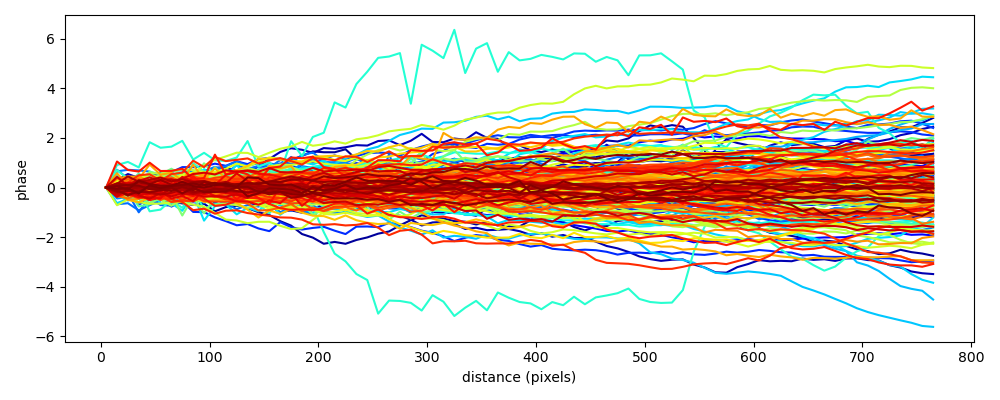

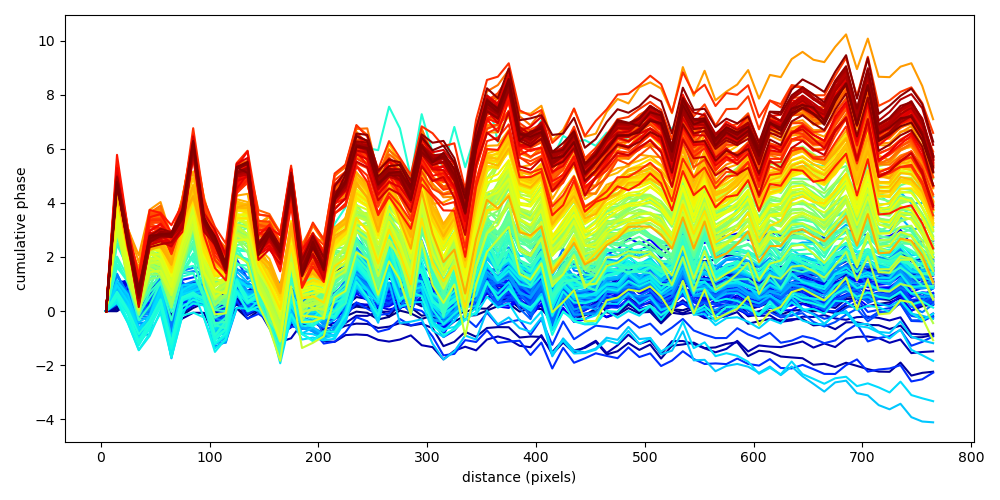

/home/rlohman/Software/anaconda3/envs/oliviaJupyter/lib/python3.9/site-packages/ipympl/backend_nbagg.py:336: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  self.figure.savefig(buf, format='png', dpi='figure')


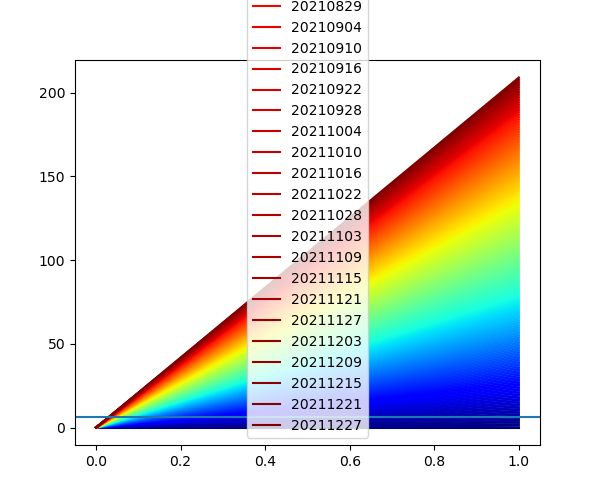

In [31]:
# plot all the sequential igrams in the specific period of time 
plt.figure(figsize=(10, 4), tight_layout=True)
plt.ylabel('phase')
plt.xlabel('distance (pixels)')
for i in np.arange(numigrams):
    # subtracting the first value from the transects so they all start at zero
    plt.plot(np.real(UnwrTscts[i,0,:]),np.real(UnwrTscts[i,1,:])-np.real(UnwrTscts[i,1,0]),'-',c=cmap1(i),markersize=5,label=dates[i+indexDate1])
#plt.xlim([-20,1100])
#plt.legend()
plt.show()

# plot all the cumulative sequential igrams in the specific period of time 
plt.figure(figsize=(10, 5), tight_layout=True)
plt.ylabel('cumulative phase')
plt.xlabel('distance (pixels)')
for i in np.arange(numigrams):
    #plt.plot(np.real(transects[i,0,:]),np.angle(transects[i,1,:]),'.-',markersize=5,label=dates[i+indexDate1])
    plt.plot(np.real(UnwrTsctsCum[i,0,:]),np.real(UnwrTsctsCum[i,1,:])-np.real(UnwrTsctsCum[i,1,0]),'-',c=cmap1(i),markersize=5,label=dates[i+indexDate1])
#plt.xlim([-20,1100])
#plt.legend()
plt.show()

# plot the legend on it's own 
plt.figure(figsize=(6, 5), tight_layout=True)
for i in np.arange(numigrams):
    #plt.plot(np.real(transects[i,0,:]),np.angle(transects[i,1,:]),'.-',markersize=5,label=dates[i+indexDate1])
    plt.plot([0,1],[0,i],'-',c=cmap1(i),label=dates[i+indexDate1])
#plt.xlim([-20,1100])
plt.axhline(y=2*np.pi)
plt.legend()
plt.show()

# add 2pi lines so eye can tell which jumps are unwrapping errors 
# cumulative means nothing if pairs are bad  

In [32]:
# distance along transect where TPC anomaly changes to normal is ~345 pixels from starting point. 
# but in pcolor, the x-axis plots as 0-77 because that's how many points we have once the transect is binned and averaged 
# so we need to find where the 345 pixels along transect corresponds
for i in range(np.shape(UnwrTsctsCum)[2]):
    print('data point '+str(i)+'     dist along tsct: '+str(np.real(UnwrTsctsCum[0,0,i])))

data point 0     dist along tsct: 5.0
data point 1     dist along tsct: 15.0
data point 2     dist along tsct: 25.0
data point 3     dist along tsct: 35.0
data point 4     dist along tsct: 45.0
data point 5     dist along tsct: 55.0
data point 6     dist along tsct: 65.0
data point 7     dist along tsct: 75.0
data point 8     dist along tsct: 85.0
data point 9     dist along tsct: 95.0
data point 10     dist along tsct: 105.0
data point 11     dist along tsct: 115.0
data point 12     dist along tsct: 125.0
data point 13     dist along tsct: 135.0
data point 14     dist along tsct: 145.0
data point 15     dist along tsct: 155.0
data point 16     dist along tsct: 165.0
data point 17     dist along tsct: 175.0
data point 18     dist along tsct: 185.0
data point 19     dist along tsct: 195.0
data point 20     dist along tsct: 205.0
data point 21     dist along tsct: 215.0
data point 22     dist along tsct: 225.0
data point 23     dist along tsct: 235.0
data point 24     dist along tsct: 24

In [33]:
# Try pcolor 

print(np.shape(UnwrTsctsCum))
#print(np.real(UnwrTsctsCum[0,1,:]))
#print(np.real(UnwrTsctsCum[0,0,:]))

# subtract the last value of each transect 
UnwrTsctsCumZeroed = np.ndarray(np.shape(UnwrTsctsCum),'complex')
for i in np.arange(0,np.shape(UnwrTsctsCum)[0]):
    UnwrTsctsCumZeroed[i,1,:] = UnwrTsctsCum[i,1,:]-UnwrTsctsCum[i,1,-1]

    
# now try subtracting the mean value for each transect 
# BUT use the mean of the region in open desert

# which indices are in this area? 

UnwrTsctsCumNorm = np.ndarray(np.shape(UnwrTsctsCum),'complex')
for i in np.arange(0,np.shape(UnwrTsctsCum)[0]):
    UnwrTsctsCumNorm[i,1,:] = UnwrTsctsCum[i,1,:]-np.mean(UnwrTsctsCum[i,1,35:-1]) # WHAT SHOULD I NORMALIZE BY? ? ?   ?     ?         ?

(210, 2, 77)


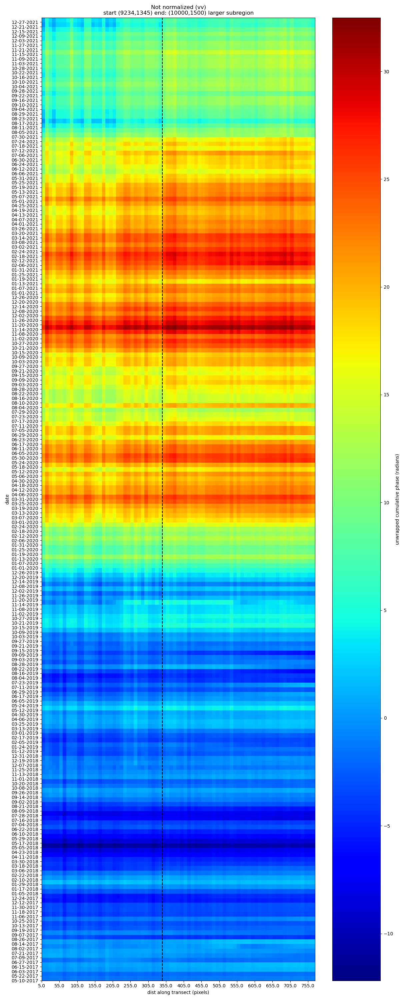

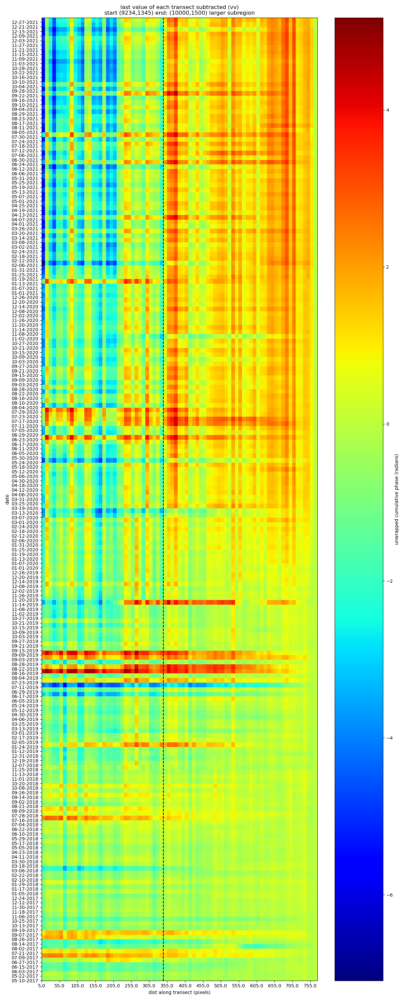

In [34]:
# Plot it in three ways using pcolor 

tsctTick = 5

plt.figure(figsize=(12, 30), tight_layout=True)
plt.ylabel('date')
plt.xlabel('dist along transect (pixels)')
# only plot phases but for all igrams and for all distances along transect 
plt.pcolor(np.real(UnwrTsctsCum[:,1,:]),cmap='jet')
# put a line where the TPC anomaly ends, is there a difference on each side? 
plt.axvline(x=34, color='k', linestyle='--')
plt.yticks(range(numigrams), plotDates)
plt.xticks(np.arange(0,np.shape(UnwrTsctsCum)[2],tsctTick),np.real(UnwrTsctsCum[0,0,::tsctTick]))
cbar = plt.colorbar()
cbar.set_label('unwrapped cumulative phase (radians)')
plt.title('Not normalized (vv)\nstart ('+str(x1)+','+str(y1)+') end: ('+str(x2)+','+str(y2)+ ') larger subregion')
plt.show()

# first value subtracted 
plt.figure(figsize=(12, 30), tight_layout=True)
plt.ylabel('date')
plt.xlabel('dist along transect (pixels)')
# only plot phases but for all igrams and for all distances along transect 
plt.pcolor(np.real(UnwrTsctsCumZeroed[:,1,:]),cmap='jet')
# put a line where the TPC anomaly ends, is there a difference on each side? 
plt.axvline(x=34, color='k', linestyle='--')
plt.yticks(range(numigrams), plotDates)
plt.xticks(np.arange(0,np.shape(UnwrTsctsCum)[2],tsctTick),np.real(UnwrTsctsCum[0,0,::tsctTick]))
cbar = plt.colorbar()
cbar.set_label('unwrapped cumulative phase (radians)')
plt.title('last value of each transect subtracted (vv)\nstart ('+str(x1)+','+str(y1)+') end: ('+str(x2)+','+str(y2)+ ') larger subregion')
plt.show()

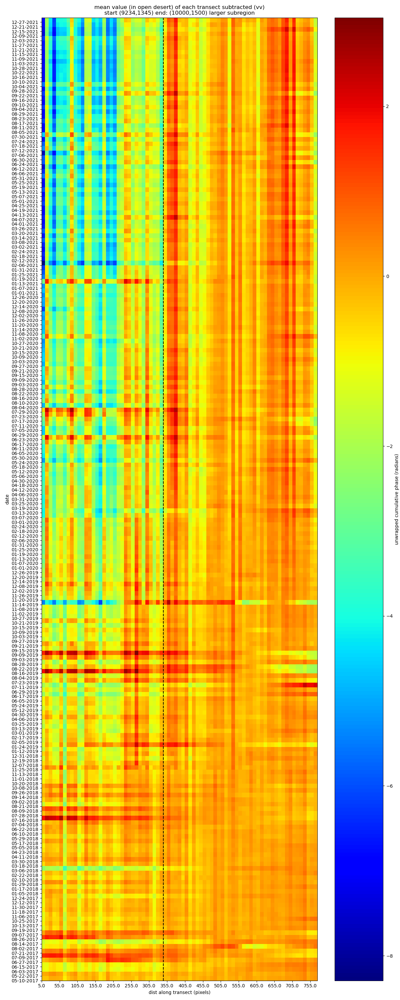

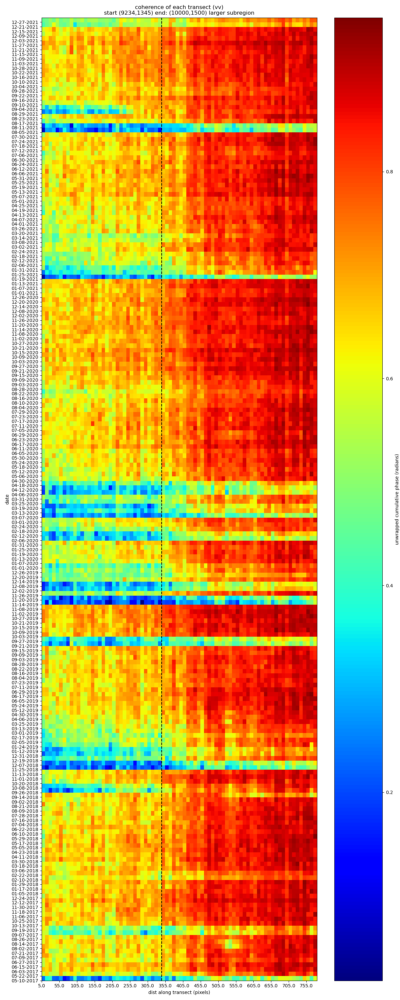

In [35]:
# Plotted very large individually 
# Normalized by the mean 
plt.figure(figsize=(12, 30), tight_layout=True)
plt.ylabel('date')
plt.xlabel('dist along transect (pixels)')
# only plot phases but for all igrams and for all distances along transect 
plt.pcolor(np.real(UnwrTsctsCumNorm[:,1,:]),cmap='jet')
# put a line where the TPC anomaly ends, is there a difference on each side? 
plt.axvline(x=34, color='k', linestyle='--')
plt.yticks(range(numigrams), plotDates)
plt.xticks(np.arange(0,np.shape(UnwrTsctsCum)[2],tsctTick),np.real(UnwrTsctsCum[0,0,::tsctTick]))
cbar = plt.colorbar()
cbar.set_label('unwrapped cumulative phase (radians)')
plt.title('mean value (in open desert) of each transect subtracted (vv)\nstart ('+str(x1)+','+str(y1)+') end: ('+str(x2)+','+str(y2)+ ') larger subregion')
plt.show()

# now plot coherence the same way 
plt.figure(figsize=(12, 30), tight_layout=True)
plt.ylabel('date')
plt.xlabel('dist along transect (pixels)')
# only plot phases but for all igrams and for all distances along transect 
plt.pcolor(np.abs(transects[:,1,:]),cmap='jet')
# put a line where the TPC anomaly ends, is there a difference on each side? 
plt.axvline(x=34, color='k', linestyle='--')
plt.yticks(range(numigrams), plotDates)
plt.xticks(np.arange(0,np.shape(UnwrTsctsCum)[2],tsctTick),np.real(UnwrTsctsCum[0,0,::tsctTick]))
cbar = plt.colorbar()
cbar.set_label('unwrapped cumulative phase (radians)')
plt.title('coherence of each transect (vv)\nstart ('+str(x1)+','+str(y1)+') end: ('+str(x2)+','+str(y2)+ ') larger subregion')
plt.show()

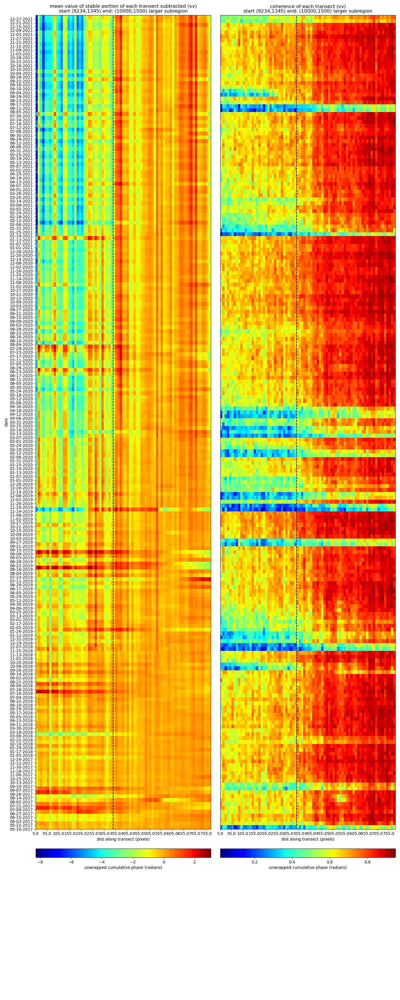

In [37]:
# plot cumulative phase transects and coherence side-by-side


plt.figure(figsize=(14, 35), tight_layout=True)

plt.subplot(1,2,1)
plt.ylabel('date')
plt.xlabel('dist along transect (pixels)')
# only plot phases but for all igrams and for all distances along transect 
plt.pcolor(np.real(UnwrTsctsCumNorm[:,1,:]),cmap='jet')
# put a line where the TPC anomaly ends, is there a difference on each side? 
plt.axvline(x=34, color='k', linestyle='--')
plt.yticks(range(numigrams), plotDates)
plt.xticks(np.arange(0,np.shape(UnwrTsctsCum)[2],tsctTick),np.real(UnwrTsctsCum[0,0,::tsctTick]))
cbar = plt.colorbar(orientation="horizontal",pad=0.02)
cbar.set_label('unwrapped cumulative phase (radians)')
plt.title('mean value of stable portion of each transect subtracted (vv)\nstart ('+str(x1)+','+str(y1)+') end: ('+str(x2)+','+str(y2)+ ') larger subregion')

# coherence
plt.subplot(1,2,2)
#plt.ylabel('date')
plt.xlabel('dist along transect (pixels)')
# only plot phases but for all igrams and for all distances along transect 
plt.pcolor(np.abs(transects[:,1,:]),cmap='jet')
# put a line where the TPC anomaly ends, is there a difference on each side? 
plt.axvline(x=34, color='k', linestyle='--')
#plt.yticks(range(numigrams), plotDates)
plt.yticks([])
plt.xticks(np.arange(0,np.shape(UnwrTsctsCum)[2],tsctTick),np.real(UnwrTsctsCum[0,0,::tsctTick]))
cbar = plt.colorbar(orientation="horizontal",pad=0.02)
cbar.set_label('unwrapped cumulative phase (radians)')
plt.title('coherence of each transect (vv)\nstart ('+str(x1)+','+str(y1)+') end: ('+str(x2)+','+str(y2)+ ') larger subregion')

plt.show()

<br><br><br><br> An idea: <br>
use pre-existing algorithm to determine how many line segments will fit the time series of cumulative deformation at each point. See at which times are the most common knickpoints located (histogram of when slope changes occur but across all pixels?). Then select those knickpoint times (where slope changes) and use those to split up the time intervals of calculating slope (how much the pixel is deforming in that time interval) over the full region